In [ ]:
! pip install ONE-api
! pip install ibllib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 113.4/113.4 kB 3.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.6/57.6 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 14.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 7.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.9/11.9 MB 43.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 82.1/82.1 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.7/8.7 MB 57.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.4/292.4 kB 32.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 16.6 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.2/80.2 kB 10.0 MB/s eta 0:00:00
     ━━━━━

In [ ]:
!git clone -b imbizo https://github.com/int-brain-lab/paper-brain-wide-map.git
%cd /content/paper-brain-wide-map
!pip install -e

Cloning into 'paper-brain-wide-map'...
remote: Enumerating objects: 1992, done.
remote: Counting objects: 100% (1097/1097), done.
remote: Compressing objects: 100% (400/400), done.
remote: Total 1992 (delta 823), reused 883 (delta 694), pack-reused 895
Receiving objects: 100% (1992/1992), 4.99 MiB | 11.56 MiB/s, done.
Resolving deltas: 100% (1259/1259), done.
/content/paper-brain-wide-map

Usage:   
  pip3 install [options] <requirement specifier> [package-index-options] ...
  pip3 install [options] -r <requirements file> [package-index-options] ...
  pip3 install [options] [-e] <vcs project url> ...
  pip3 install [options] [-e] <local project path> ...
  pip3 install [options] <archive url/path> ...

-e option requires 1 argument


In [ ]:
# Instanciate the ONE cache
from pathlib import Path
ibl_cache = Path.home() / 'Downloads' / 'IBL_Cache'
ibl_cache.mkdir(exist_ok=True, parents=True)

# Setup the ONE API
from one.api import ONE
ONE.setup(silent=True)

IBLParams(CLIENT_MAP={'openalyx.internationalbrainlab.org': '/root/Downloads/ONE/openalyx.internationalbrainlab.org'}, DEFAULT='openalyx.internationalbrainlab.org')

In [ ]:
from one.api import ONE
from brainbox.population.decode import get_spike_counts_in_bins
from brainbox.io.one import SpikeSortingLoader, SessionLoader
from brainbox.ephys_plots import plot_brain_regions
from brainbox.behavior.wheel import velocity
from brainbox.task.trials import get_event_aligned_raster, get_psth
from ibllib.atlas import AllenAtlas
from brainwidemap import bwm_query
from brainwidemap.imbizo.encoding_functions import get_choice_time_shuffle
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

one = ONE(base_url='https://openalyx.internationalbrainlab.org', \
          password='international', silent=True, cache_dir=ibl_cache)

ba = AllenAtlas()

/usr/local/lib/python3.10/dist-packages/ibllib/atlas/__init__.py:205: DeprecationWarning: ibllib.atlas is deprecated. Please install iblatlas using "pip install iblatlas" and use this module instead
  warnings.warn('ibllib.atlas is deprecated. Please install iblatlas using "pip install iblatlas" and use '
/usr/local/lib/python3.10/dist-packages/ibllib/atlas/atlas.py:13: DeprecationWarning: ibllib.atlas.atlas.AllenAtlas is deprecated. Use iblatlas.atlas.AllenAtlas instead
  warnings.warn(warning_text, DeprecationWarning)


Downloading: /root/Downloads/ONE/openalyx.internationalbrainlab.org/histology/ATLAS/Needles/Allen/average_template_25.nrrd Bytes: 32998960


100%|██████████| 31.470260620117188/31.470260620117188 [00:05<00:00,  5.33it/s]


Downloading: /root/Downloads/ONE/openalyx.internationalbrainlab.org/histology/ATLAS/Needles/Allen/annotation_25.nrrd Bytes: 4035363


100%|██████████| 3.848422050476074/3.848422050476074 [00:03<00:00,  1.11it/s]


In [ ]:
import pandas as pd

Place to search for region acronym https://search.brain-map.org/search/index.html?query=posterior%20parietal%20cortex&fa=false&e_sp=t&e_ag=t&e_tr=t&e_fa=t

In [ ]:
acronym = 'STR'
insertions = one.search_insertions(atlas_acronym=acronym, query_type='remote')

In [ ]:
#sessions = one.search(atlas_acronym=acronym, query_type='remote')

In [ ]:
# one = ONE()
# eid = 'f4eb56a4-8bf8-4bbc-a8f3-6e6535134bad'
# trials = one.load_object(eid, 'trials', collection='alf')

In [ ]:
# trials.to_df()

In [ ]:
len(insertions)

154

In [ ]:
from tqdm import tqdm

In [ ]:
# np.save('good_STR_count.npy', good_STR_lst)

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

# np.save('/content/drive/My Drive/good_STR_count1.npy', good_STR_lst)

In [ ]:
# ---------------------------------------------------
# Select your PID
pid = insertions[23] #10


# ---------------------------------------------------
# Convert probe PID to session EID and probe name
[eid, pname] = one.pid2eid(pid)

# ---------------------------------------------------
# Load spike data
ssl = SpikeSortingLoader(pid=pid, one=one, atlas=ba) #what is ba, it is brainmap
spikes, clusters, channels = ssl.load_spike_sorting() #what is the diff btw spikes, clusters, channels?
clusters = ssl.merge_clusters(spikes, clusters, channels)

# ---------------------------------------------------
# Restrict to only good clusters
# Find the good cluster index:
good_cluster_idx = clusters['label'] == 1 #to do: what does 1 mean, default idx staring from 0
good_cluster_IDs = clusters['cluster_id'][good_cluster_idx] #label index
# Filter the clusters accordingly:
clusters_g = {key: val[good_cluster_idx] for key, val in clusters.items()}
# Filter the spikes accordingly:
good_spk_indx = np.where(np.isin(spikes['clusters'], good_cluster_IDs))
spikes_g = {key: val[good_spk_indx] for key, val in spikes.items()}

# ---------------------------------------------------
# N neuronal units in total
num_neuron = len(np.unique(spikes_g['clusters'])) #to do: is neuronal units = individual cell

# ---------------------------------------------------
# Load trial data
sl = SessionLoader(eid=eid, one=one)
sl.load_trials()
events = sl.trials['firstMovement_times'] #only will get movement related cell, can also ask about stimulus, session start
#what propotion of cells are responsive to..., need to report that number
#do not filter cells with diff function

# If event == NaN, remove the trial from the analysis
nan_index = np.where(np.isnan(events))[0]
events = events.drop(index=nan_index).to_numpy()
contrast_R = sl.trials.contrastRight.drop(index=nan_index).to_numpy() #contrast of the stimulus appear on the right side of the screen
contrast_L = sl.trials.contrastLeft.drop(index=nan_index).to_numpy()
choice = sl.trials.choice.drop(index=nan_index).to_numpy() #response type: -1 turning the wheel counter clockwise, left +1 right 0 time out (didn't thurn the wheel)
block = sl.trials.probabilityLeft.drop(index=nan_index).to_numpy() #prob the stimulus will be on the left of the screen for the current trial

# N trial count
num_trial = len(events) #the event is when the mouse moves the trial

# Find "trials" that go in one direction and the other direction
# Note: This is not a pure indexing on the *task trials* as we removed trials with nan values previously
indx_choice_a = np.where(choice == -1)[0] #turning left
indx_choice_b = np.where(choice == 1)[0] #turning right

# ---------------------------------------------------
# Load wheel data
# wheel = one.load_object(eid, 'wheel', collection='alf')
# speed = velocity(wheel.timestamps, wheel.position)

/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/spikes.depths.npy: 100%|██████████| 153M/153M [00:01<00:00, 99.8MB/s]
/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/spikes.times.npy: 100%|██████████| 153M/153M [00:01<00:00, 134MB/s]
/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/spikes.clusters.npy: 100%|██████████| 76.5M/76.5M [00:00<00:00, 140MB/s]
/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/spikes.amps.npy: 100%|██████████| 153M/153M [00:01<00:00, 109MB/s]
/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/clusters.metrics.pqt: 100%|██████████| 122k/122k [00:00<00:00, 1.05MB/s]
/root/Downloads/IBL_Cache/churchlandlab_ucla/Subjects/UCLA034/2022-01-26/001/alf/probe00/pykilosort/clusters.depths.npy: 100%|██████████| 4.24k/4.24k

In [ ]:
# 2. Evaluate the number of good clusters
# The spikesortingloader loads data for all clusters (both mua and good) detected by the spikesorter.
# We can restrict to only the good clusters by finding the clusters with a label of 1
good_cluster_idx = clusters['label'] == 1
clusters_good = {key:val[good_cluster_idx] for key, val in clusters.items()}

all_clusters = clusters['label'].shape
good_clusters = clusters_good['label'].shape
print(f'Total no. of clusters: {all_clusters}')
print(f'Number of good clusters: {good_clusters}')

Total no. of clusters: (1028,)
Number of good clusters: (202,)


In [ ]:
# 3. Find the location of clusters in brain
# The location of the clusters can be found in the atlas_id (Allen CCF ids) or acronym attributes of the clusters object
# To do: is 2 a good number of cluster
acronyms = clusters_good['acronym']
unique_acronyms, count = np.unique(acronyms, return_counts=True)
for a, c in zip(unique_acronyms, count):
  print(f'{a}: {c}')

ACAd6a: 6
ACAv6a: 5
ACAv6b: 9
LSr: 71
MOs2/3: 1
MOs5: 35
MOs6a: 7
MS: 10
PL6a: 1
SEZ: 3
STR: 38
ccg: 4
cing: 12


In [ ]:
#units, alligned spike counts (movement spike count), plot psth for left and right
#raster plot for individual trail

In [ ]:
good_cluster_df = pd.DataFrame(clusters_good)
good_cluster_df.head()

,depths,channels,uuids,cluster_id,amp_max,amp_min,amp_median,amp_std_dB,contamination,contamination_alt,...,spike_count,firing_rate,label,x,y,z,acronym,atlas_id,axial_um,lateral_um
3,60.0,4,ddc28c36-30a6-4755-b590-592ee18a61a8,3,0.000300,0.000086,0.000163,1.750074,0.001586,0.001529,...,194919.0,33.510905,1.0,-0.000020,0.000831,-0.004616,MS,564,60.0,43.0
6,80.0,6,ac172d96-b304-47c2-9bc0-ea29fab121fc,6,0.000599,0.000131,0.000321,2.358386,0.332343,0.248435,...,19686.0,3.384461,1.0,-0.000024,0.000836,-0.004597,MS,564,80.0,59.0
9,100.0,9,69073c1f-3a79-46b7-8e9f-281141314b07,9,0.000414,0.000110,0.000213,2.197686,0.004947,0.004596,...,108432.0,18.641869,1.0,-0.000029,0.000841,-0.004578,MS,564,100.0,11.0
12,120.0,10,cf483038-562a-4ed0-aaa6-d87c19e0d050,12,0.000503,0.000168,0.000311,1.405882,0.986266,0.581883,...,19144.0,3.291279,1.0,-0.000033,0.000845,-0.004559,MS,564,120.0,59.0
23,200.0,18,273f8056-9878-4061-8d9c-20f3acaaee6a,23,0.000541,0.000132,0.000264,1.324375,0.000191,0.000178,...,147489.0,25.356635,1.0,-0.000072,0.000850,-0.004491,MS,564,200.0,59.0


In [ ]:
#we need to make sure the eid contain STR
STR_df = good_cluster_df[good_cluster_df['acronym']=='STR']
STR_df.columns

Index(['depths', 'channels', 'uuids', 'cluster_id', 'amp_max', 'amp_min',
       'amp_median', 'amp_std_dB', 'contamination', 'contamination_alt',
       'drift', 'missed_spikes_est', 'noise_cutoff', 'presence_ratio',
       'presence_ratio_std', 'slidingRP_viol', 'spike_count', 'firing_rate',
       'label', 'x', 'y', 'z', 'acronym', 'atlas_id', 'axial_um',
       'lateral_um'],
      dtype='object')

In [ ]:
sl.trials.head()

,stimOff_times,goCueTrigger_times,contrastRight,contrastLeft,firstMovement_times,rewardVolume,feedbackType,feedback_times,response_times,stimOn_times,probabilityLeft,choice,goCue_times,intervals_0,intervals_1
0,26.069935,24.323034,NaN,1.000,24.552227,1.5,1.0,25.003465,25.003346,24.322860,0.5,1.0,24.323693,23.642322,26.569975
1,29.272578,27.689992,NaN,0.125,27.855227,1.5,1.0,28.199808,28.199700,27.689854,0.5,1.0,27.690721,27.020682,29.772626
2,32.453056,30.853347,NaN,1.000,30.977227,1.5,1.0,31.395652,31.395561,30.853167,0.5,1.0,30.854067,30.164630,32.953100
3,35.586371,34.122721,0.0625,NaN,34.326227,1.5,1.0,34.522101,34.522027,34.122571,0.5,-1.0,34.123404,33.337609,36.086453
4,38.936667,37.206372,NaN,0.250,37.316227,1.5,1.0,37.869264,37.869184,37.206191,0.5,1.0,37.207058,36.466358,39.436714


Raster Plot 1

In [ ]:
# 1. Load in trials data and spikesorting data
# from brainbox.io.one import SessionLoader, SpikeSortingLoader
# from one.api import ONE
# from iblatlas.atlas import AllenAtlas
# import numpy as np

# ba = AllenAtlas()
# one = ONE()
# pid = '695476f6-4c14-4a2f-b658-948514629079'
# eid, _ = one.pid2eid(pid)

# sl = SessionLoader(eid=eid, one=one)
# sl.load_trials()

# ssl = SpikeSortingLoader(one=one, pid=pid, atlas=ba)
# spikes, clusters, channels = ssl.load_spike_sorting()
# clusters = ssl.merge_clusters(spikes, clusters, channels)
np.array(STR_df['cluster_id'])

array([265, 266, 267, 268, 271, 272, 280, 281, 285, 286, 289, 291, 293,
       294, 295, 297, 299, 301, 304, 305, 308, 313, 317, 319, 320, 326,
       330, 332, 333, 339, 345, 349, 352, 353, 356, 747, 754, 758])

In [ ]:
from brainbox.io.one import SessionLoader, SpikeSortingLoader
from one.api import ONE
from iblatlas.atlas import AllenAtlas
import numpy as np
import matplotlib.pyplot as plt
# 2. Get spikes for a single cluster
# Get the 25th good cluster
cluster_id = STR_df['cluster_id'][266]
cluster_id

266

In [ ]:
# Get the index of the spikes object for the chosen cluster
spikes_idx = spikes['clusters'] == cluster_id
spikes_idx.mean()

0.0006735361284821159

In [ ]:
#spikes.times

In [ ]:
# from brainbox.processing import bincount2D
# from iblutil.util import Bunch
# import copy

In [ ]:
#good_cluster_idx, clusters
idx = np.where(clusters.label == 1)[0]

In [ ]:
def _filter(obj, idx):
  obj = Bunch(copy.deepcopy(obj))
  for key in obj.keys():
      obj[key] = obj[key][idx]

  return obj



In [ ]:
# trials = _filter(clusters, idx)
#trails

In [ ]:
# # 3. Compute firing rate of cluster around trial event and plot as a raster
# Find times when stimulus appears
events = sl.trials['stimOn_times']
#print('e', events)
movement = sl.trials['firstMovement_times']

feedback = sl.trials['feedback_times']
#print('f',feedback)
gap1 = sl.trials['firstMovement_times'] - sl.trials['stimOn_times']
#print('g1',gap1)
gap2 = sl.trials['feedback_times'] - sl.trials['stimOn_times']
# #print('g2',gap2)
from brainbox.singlecell import bin_spikes

# # Compute number of spikes in 0.07s bins between 0.5s before stimulus presentation to 3s after stimulus presentation
# bin_size = 0.07#0.05
# pre_time = 0.5
# post_time = 3
# spike_raster, times = bin_spikes(spikes.times[spikes_idx], events, pre_time=pre_time, post_time=post_time, bin_size=bin_size)
# spikes_raster = spike_raster / bin_size
# #print(spikes_raster)

# fig, ax = plt.subplots()
# ax.imshow(spike_raster, extent=[times[0], times[-1], 0, events.size], origin='lower', cmap='binary', aspect='auto', vmax=5, vmin=0)
# ax.axvline(0, c='k', linestyle='--')
# ax.axvline(gap1[0], c='r', linestyle='--')
# ax.axvline(gap2[0], c='g', linestyle='--')
# ax.set_xlabel('Time from stimulus (s)')
# ax.set_ylabel('Trial number')

/usr/local/lib/python3.10/dist-packages/brainbox/singlecell.py:48: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ts = np.repeat(align_times[:, np.newaxis], tscale.size, axis=1) + tscale


Text(0, 0.5, 'Trial number')

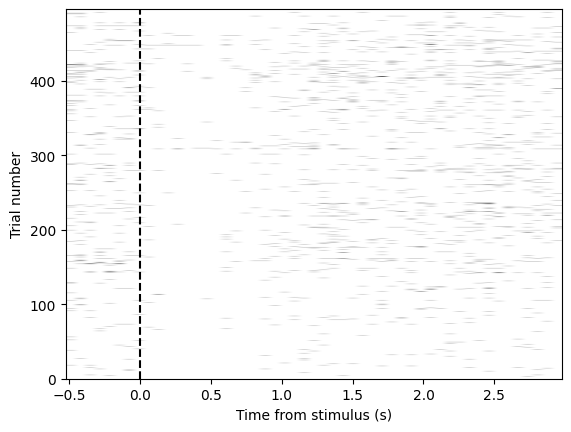

In [ ]:
bin_size = 0.07#0.05
pre_time = 0.5
post_time = 3
spike_raster2, times = bin_spikes(spikes.times[spikes_idx], movement, pre_time=pre_time, post_time=post_time, bin_size=bin_size)
spikes_raster2 = spike_raster2 / bin_size
#print(spikes_raster)

fig, ax = plt.subplots()
ax.imshow(spike_raster2, extent=[times[0], times[-1], 0, movement.size], origin='lower', cmap='binary', aspect='auto', vmax=5, vmin=0)
ax.axvline(0, c='k', linestyle='--')

ax.set_xlabel('Time from stimulus (s)')
ax.set_ylabel('Trial number')

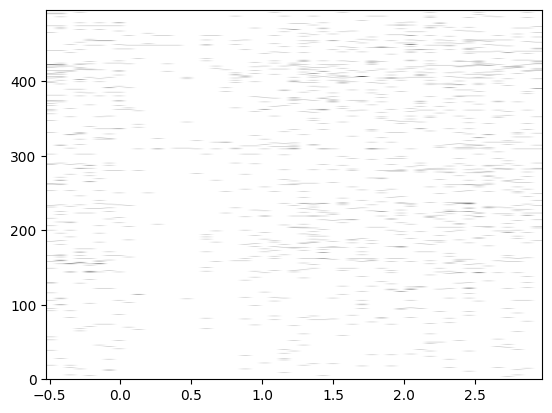

In [ ]:
bin_size = 0.07#0.05
pre_time = 0.5
post_time = 3
spike_raster2, times = bin_spikes(spikes.times[spikes_idx], movement, pre_time=pre_time, post_time=post_time, bin_size=bin_size)
spikes_raster2 = spike_raster2 / bin_size
#print(spikes_raster)

fig, ax = plt.subplots()
ax.imshow(spike_raster2, extent=[times[0], times[-1], 0, movement.size], origin='lower', cmap='binary', aspect='auto', vmax=5, vmin=0)

In [ ]:
spikes.times

array([1.03251145e-02, 1.12917831e-02, 1.16584505e-02, ...,
       5.81659131e+03, 5.81659348e+03, 5.81659448e+03])

## new Raster+PSTH(Week4)

In [ ]:
from brainbox.task.trials import find_trial_ids
from brainbox.singlecell import bin_spikes
def single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
                              norm=False, axs=None):
  """
  Compute and plot trial aligned spike rasters and psth
  :param spike_times: times of variable
  :param events: trial times to align to
  :param trial_idx: trial idx to sort by
  :param dividers:
  :param colors:
  :param labels:
  :param weights:
  :param fr:
  :param norm:
  :param axs:
  :return:
  """
  pre_time = 0.5
  post_time = 3
  raster_bin = 0.07
  psth_bin = 0.05
  raster, t_raster = bin_spikes(
      spike_times, events, pre_time=pre_time, post_time=post_time, bin_size=raster_bin, weights=weights)
  psth, t_psth = bin_spikes(
      spike_times, events, pre_time=pre_time, post_time=post_time, bin_size=psth_bin, weights=weights)

  if fr:
      psth = psth / psth_bin

  if norm:
      psth = psth - np.repeat(psth[:, 0][:, np.newaxis], psth.shape[1], axis=1)
      raster = raster - np.repeat(raster[:, 0][:, np.newaxis], raster.shape[1], axis=1)

  dividers = [0] + dividers + [len(trial_idx)]
  if axs is None:
      fig, axs = plt.subplots(2, 1, figsize=(4, 6), gridspec_kw={'height_ratios': [1, 3], 'hspace': 0}, sharex=True)
  else:
      fig = axs[0].get_figure()

  label, lidx = np.unique(labels, return_index=True)
  label_pos = []
  for lab, lid in zip(label, lidx):
      idx = np.where(np.array(labels) == lab)[0]
      for iD in range(len(idx)):
          if iD == 0:
              t_ids = trial_idx[dividers[idx[iD]] + 1:dividers[idx[iD] + 1] + 1]
              t_ints = dividers[idx[iD] + 1] - dividers[idx[iD]]
          else:
              t_ids = np.r_[t_ids, trial_idx[dividers[idx[iD]] + 1:dividers[idx[iD] + 1] + 1]]
              t_ints = np.r_[t_ints, dividers[idx[iD] + 1] - dividers[idx[iD]]]

      psth_div = np.nanmean(psth[t_ids], axis=0)
      std_div = np.nanstd(psth[t_ids], axis=0) / np.sqrt(len(t_ids))

      axs[0].fill_between(t_psth, psth_div - std_div, psth_div + std_div, alpha=0.4, color=colors[lid])
      axs[0].plot(t_psth, psth_div, alpha=1, color=colors[lid])

      lab_max = idx[np.argmax(t_ints)]
      label_pos.append((dividers[lab_max + 1] - dividers[lab_max]) / 2 + dividers[lab_max])

  axs[1].imshow(raster[trial_idx], cmap='binary', origin='lower',
                extent=[np.min(t_raster), np.max(t_raster), 0, len(trial_idx)], aspect='auto')

  width = raster_bin * 4
  for iD in range(len(dividers) - 1):
      axs[1].fill_between([post_time + raster_bin / 2, post_time + raster_bin / 2 + width],
                          [dividers[iD + 1], dividers[iD + 1]], [dividers[iD], dividers[iD]], color=colors[iD])

  axs[1].set_xlim([-1 * pre_time, post_time + raster_bin / 2 + width])
  secax = axs[1].secondary_yaxis('right')

  secax.set_yticks(label_pos)
  secax.set_yticklabels(label, rotation=90, rotation_mode='anchor', ha='center')
  for ic, c in enumerate(np.array(colors)[lidx]):
      secax.get_yticklabels()[ic].set_color(c)

  axs[0].axvline(0, *axs[0].get_ylim(), c='k', ls='--', zorder=10)  # TODO this doesn't always work
  axs[1].axvline(0, *axs[1].get_ylim(), c='k', ls='--', zorder=10)

  return fig, axs

def set_axis_style(ax, fontsize=12, **kwargs):
  ax.spines['right'].set_visible(False)
  ax.spines['top'].set_visible(False)

  ax.set_xlabel(kwargs.get('xlabel', None), fontsize=fontsize)
  ax.set_ylabel(kwargs.get('ylabel', None), fontsize=fontsize)
  ax.set_title(kwargs.get('title', None), fontsize=fontsize)

  return ax

In [ ]:
np.array(STR_df['cluster_id'])

array([265, 266, 267, 268, 271, 272, 280, 281, 285, 286, 289, 291, 293,
       294, 295, 297, 299, 301, 304, 305, 308, 313, 317, 319, 320, 326,
       330, 332, 333, 339, 345, 349, 352, 353, 356, 747, 754, 758])

In [ ]:
id = 266

In [ ]:
spikes_idx = spikes['clusters'] == id

In [ ]:
print(sl.trials['firstMovement_times'])

0        24.552227
1        27.855227
2        30.977227
3        34.326227
4        37.316227
          ...     
491    4246.045227
492    4259.735227
493            NaN
494            NaN
495    4516.953227
Name: firstMovement_times, Length: 496, dtype: float64


<Axes: ylabel='Firing Rate (Hz)'>

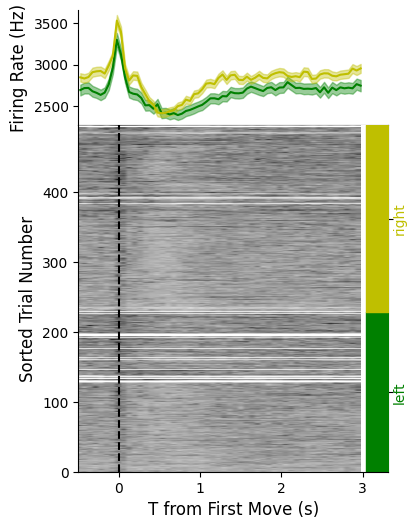

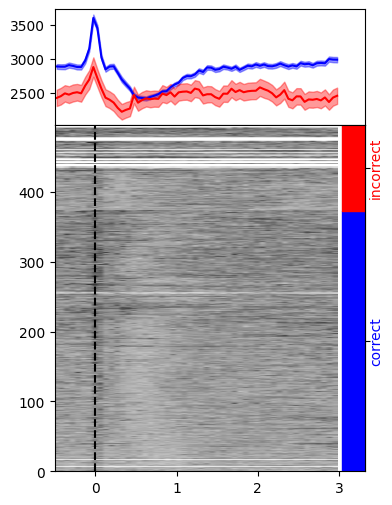

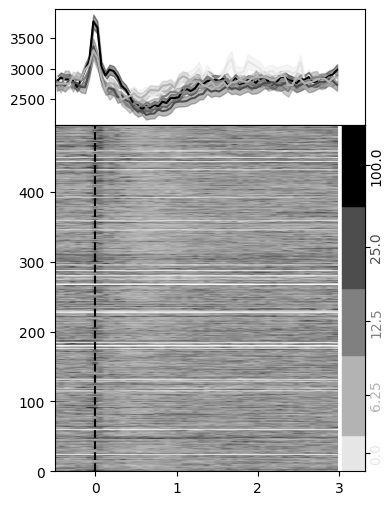

In [ ]:
#for all region, firstMovement_times
from brainbox.task.trials import find_trial_ids
order='trial num'

xlabel='T from First Move (s)'
label='T from First Move (s)'
ylabel0='Firing Rate (Hz)'
ylabel1='Sorted Trial Number'

trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
# single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
#                               norm=False, axs=None):
fig, axs = single_cluster_raster(
            spikes.times, sl.trials['firstMovement_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
fig2, axs2 = single_cluster_raster(
            spikes.times, sl.trials['firstMovement_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])

#sorted by visual stimulus contrasts (0, 6.25, 12.5, 25, 100%, from pale to dark gray) and aligned to the visual stimulus onset
contrasts = np.nanmean(np.c_[sl.trials.contrastLeft, sl.trials.contrastRight], axis=1)
trial_idx3 = np.argsort(contrasts)
dividers3 = list(np.where(np.diff(np.sort(contrasts)) != 0)[0])
labels = [str(_ * 100) for _ in np.unique(contrasts)]
colors = ['0.9', '0.7', '0.5', '0.3', '0.0']
fig3, axs3 = single_cluster_raster(spikes.times, sl.trials['firstMovement_times'], trial_idx3, dividers3, colors, labels)

set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
set_axis_style(axs[0], ylabel=ylabel0)

set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
set_axis_style(axs[0], ylabel=ylabel0)


<Axes: ylabel='Firing Rate (Hz)'>

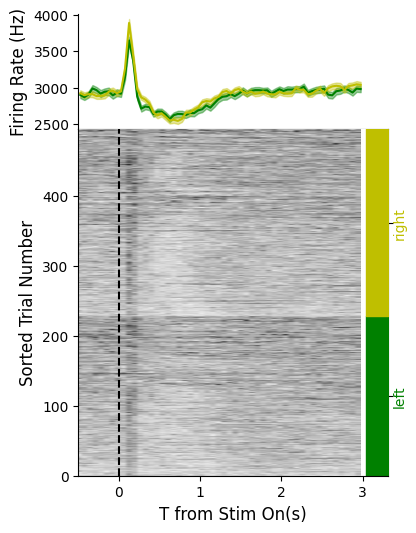

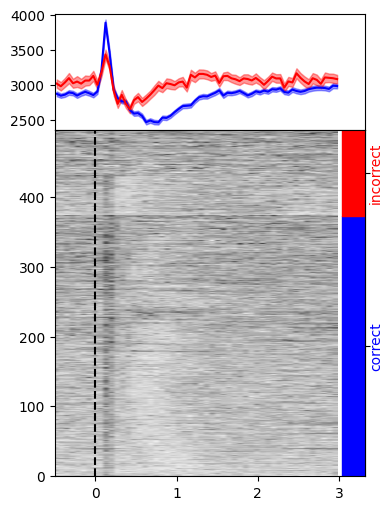

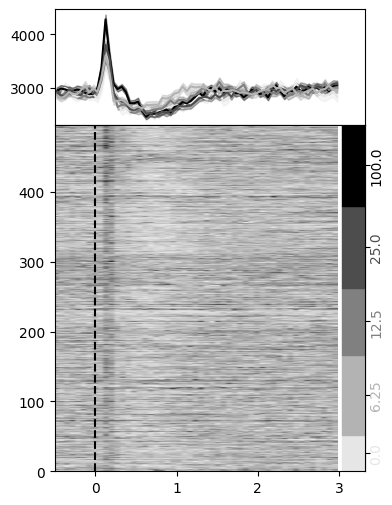

In [ ]:
#for all region, stimOn_times
from brainbox.task.trials import find_trial_ids
order='trial num'

xlabel='T from Stim On(s)'
label='T from Stim On (s)'
ylabel0='Firing Rate (Hz)'
ylabel1='Sorted Trial Number'

trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
# single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
#                               norm=False, axs=None):
fig, axs = single_cluster_raster(
            spikes.times, sl.trials['stimOn_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
fig2, axs2 = single_cluster_raster(
            spikes.times, sl.trials['stimOn_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])

contrasts = np.nanmean(np.c_[sl.trials.contrastLeft, sl.trials.contrastRight], axis=1)
trial_idx3 = np.argsort(contrasts)
dividers3 = list(np.where(np.diff(np.sort(contrasts)) != 0)[0])
labels = [str(_ * 100) for _ in np.unique(contrasts)]
colors = ['0.9', '0.7', '0.5', '0.3', '0.0']
fig3, axs3 = single_cluster_raster(spikes.times, sl.trials['stimOn_times'], trial_idx3, dividers3, colors, labels)

set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
set_axis_style(axs[0], ylabel=ylabel0)

<Axes: ylabel='Firing Rate (Hz)'>

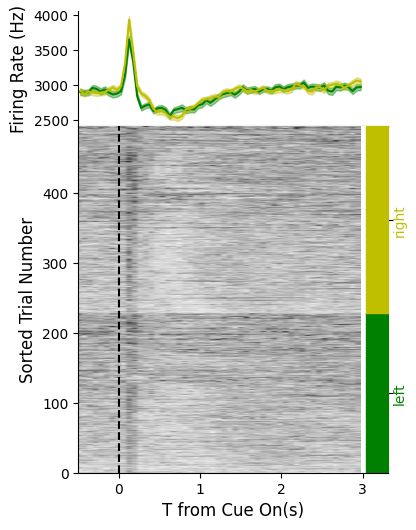

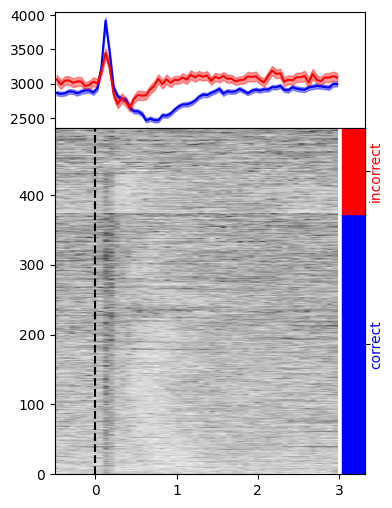

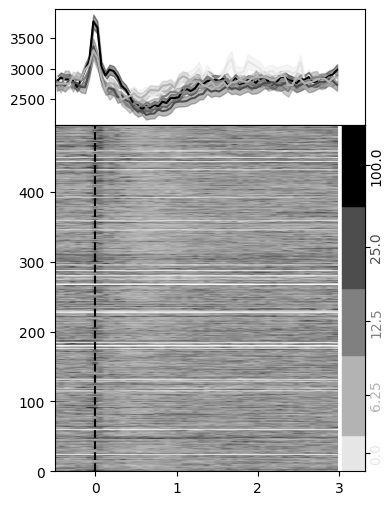

In [ ]:
# all region, goCue_times: The start time of the go cue tone. This is the time the sound is actually played, that is, the command sent through soundcard sync was fed back into Bpod.
#for all region, stimOn_times
from brainbox.task.trials import find_trial_ids
order='trial num'

xlabel='T from Cue On(s)'
label='T from Cue On (s)'
ylabel0='Firing Rate (Hz)'
ylabel1='Sorted Trial Number'

trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
# single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
#                               norm=False, axs=None):
fig, axs = single_cluster_raster(
            spikes.times, sl.trials['goCue_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
fig2, axs2 = single_cluster_raster(
            spikes.times, sl.trials['goCue_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])

contrasts = np.nanmean(np.c_[sl.trials.contrastLeft, sl.trials.contrastRight], axis=1)
trial_idx3 = np.argsort(contrasts)
dividers3 = list(np.where(np.diff(np.sort(contrasts)) != 0)[0])
labels = [str(_ * 100) for _ in np.unique(contrasts)]
colors = ['0.9', '0.7', '0.5', '0.3', '0.0']
fig3, axs3 = single_cluster_raster(spikes.times, sl.trials['goCue_times'], trial_idx3, dividers3, colors, labels)

set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
set_axis_style(axs[0], ylabel=ylabel0)

<Axes: ylabel='Firing Rate (Hz)'>

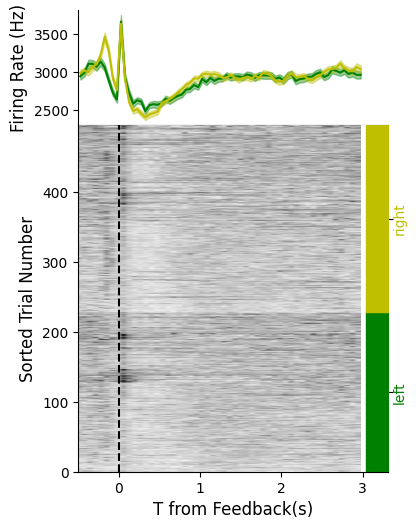

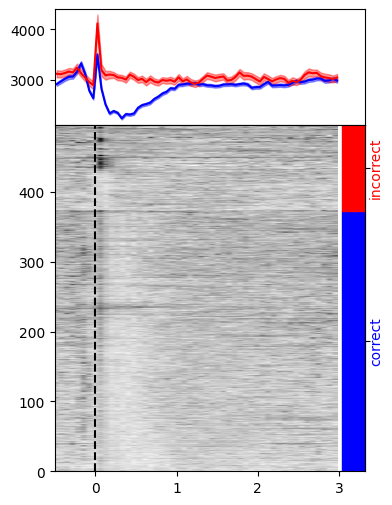

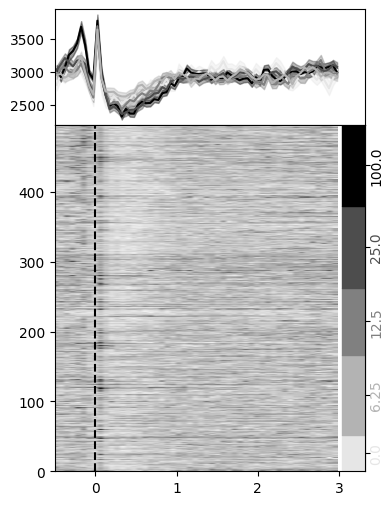

In [ ]:
# all region, feedback_times
from brainbox.task.trials import find_trial_ids
order='trial num'

xlabel='T from Feedback(s)'
label='T from Feedback (s)'
ylabel0='Firing Rate (Hz)'
ylabel1='Sorted Trial Number'

trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
# single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
#                               norm=False, axs=None):
fig, axs = single_cluster_raster(
            spikes.times, sl.trials['feedback_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
fig2, axs2 = single_cluster_raster(
            spikes.times, sl.trials['feedback_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])

contrasts = np.nanmean(np.c_[sl.trials.contrastLeft, sl.trials.contrastRight], axis=1)
trial_idx3 = np.argsort(contrasts)
dividers3 = list(np.where(np.diff(np.sort(contrasts)) != 0)[0])
labels = [str(_ * 100) for _ in np.unique(contrasts)]
colors = ['0.9', '0.7', '0.5', '0.3', '0.0']
fig3, axs3 = single_cluster_raster(spikes.times, sl.trials['feedback_times'], trial_idx3, dividers3, colors, labels)


set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
set_axis_style(axs[0], ylabel=ylabel0)

<ipython-input-36-944bcb30b1dd>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(2, 1, figsize=(4, 6), gridspec_kw={'height_ratios': [1, 3], 'hspace': 0}, sharex=True)


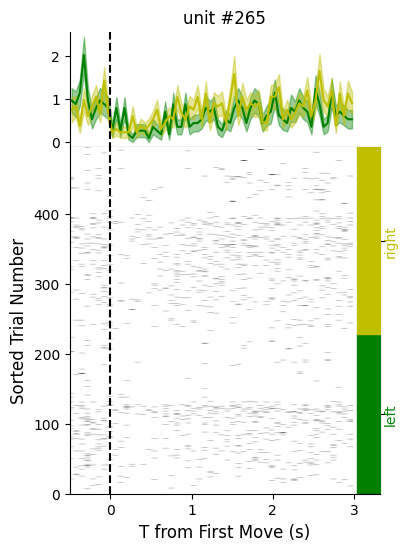

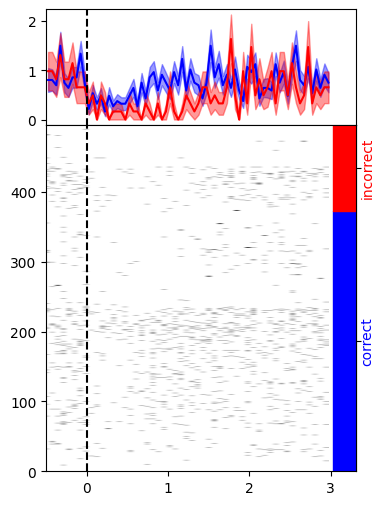

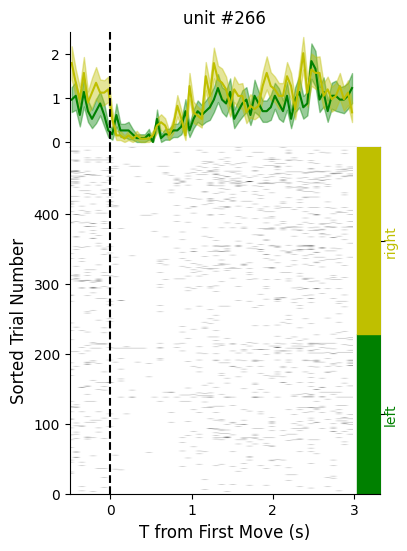

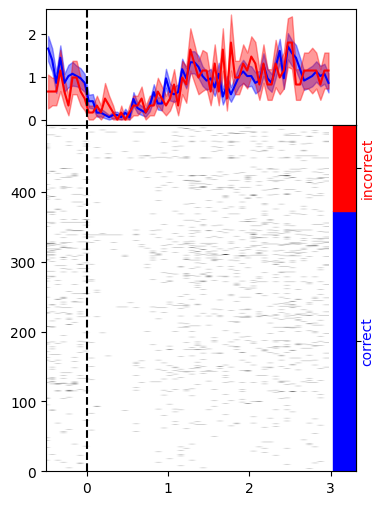

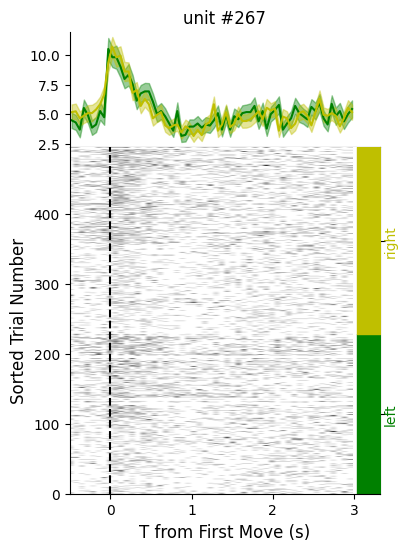

...

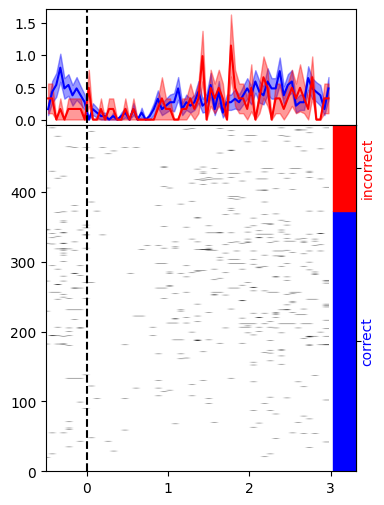

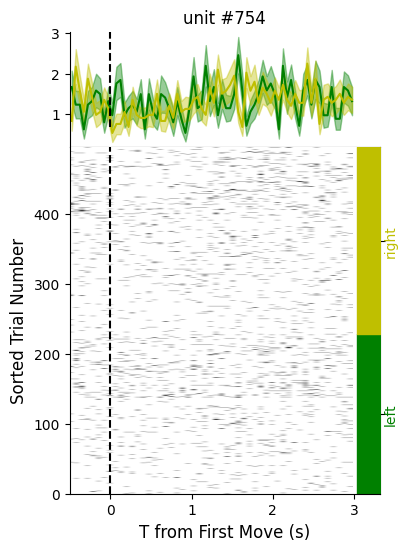

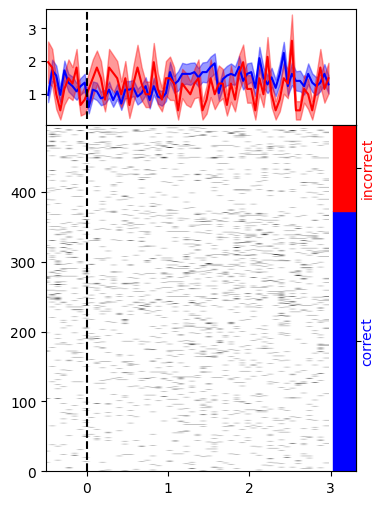

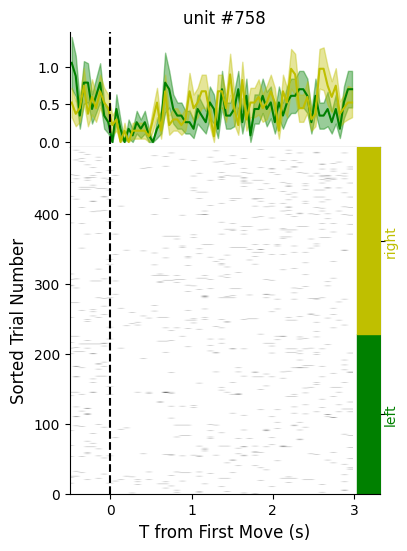

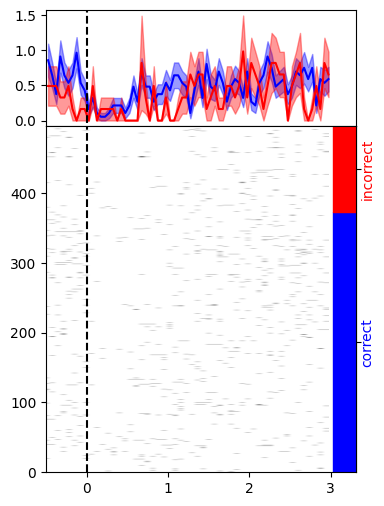

In [ ]:
# only for STR region, firstMovement_times
from brainbox.task.trials import find_trial_ids
for ids in np.array(STR_df['cluster_id']):

  spikes_idx = spikes['clusters'] == ids
  order='trial num'

  xlabel='T from First Move (s)'
  label='T from First Move (s)'
  ylabel0='Firing Rate (Hz)'
  ylabel1='Sorted Trial Number'

  trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
  trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
  # single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
  #                               norm=False, axs=None):
  fig, axs = single_cluster_raster(
              spikes.times[spikes_idx], sl.trials['firstMovement_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
  fig2, axs2 = single_cluster_raster(
              spikes.times[spikes_idx], sl.trials['firstMovement_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])
  set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
  set_axis_style(axs[0], ylabel=ylabel0)
  set_axis_style(axs[0], title="unit #"+str(ids))

<ipython-input-36-944bcb30b1dd>:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(2, 1, figsize=(4, 6), gridspec_kw={'height_ratios': [1, 3], 'hspace': 0}, sharex=True)


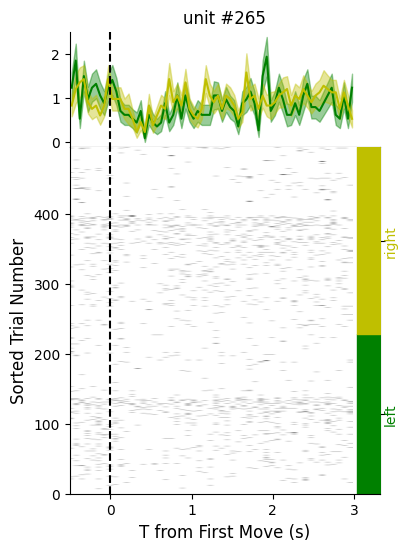

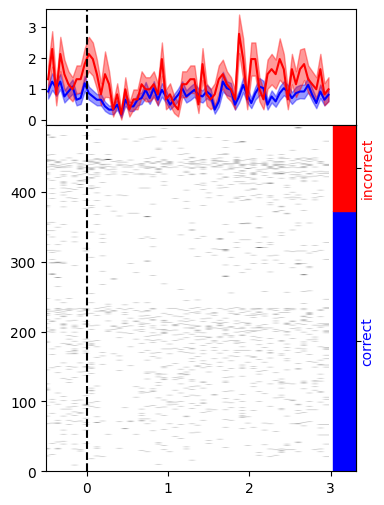

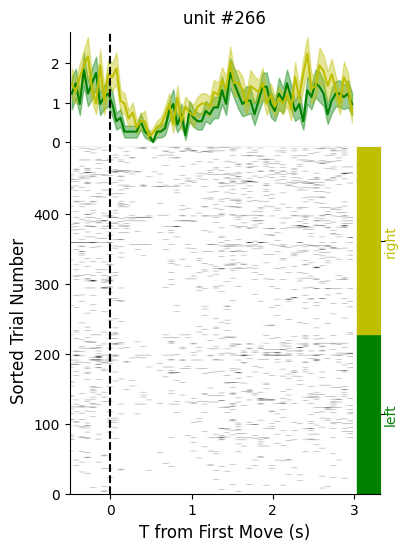

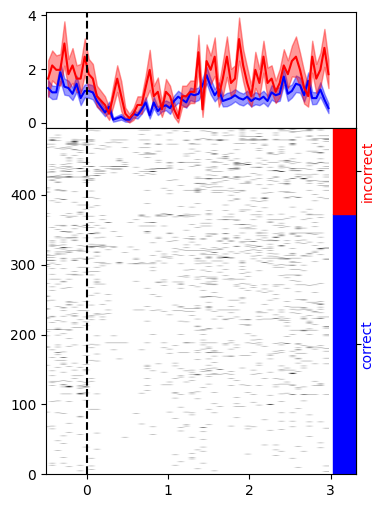

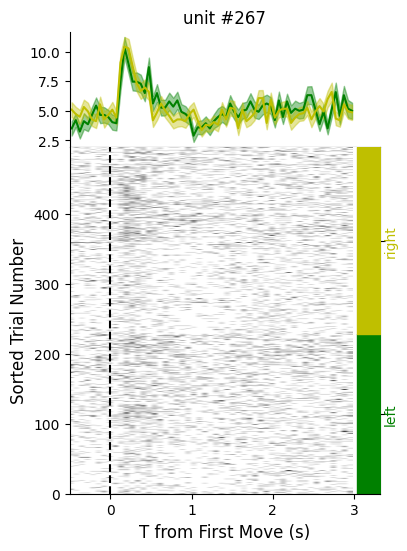

...

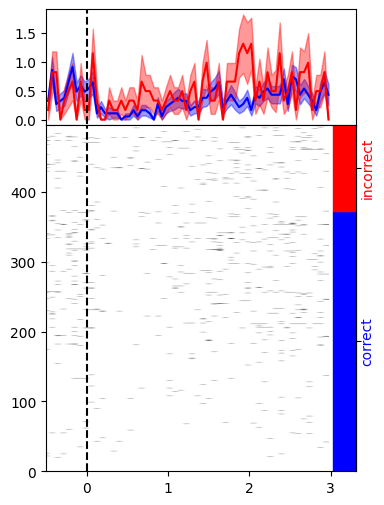

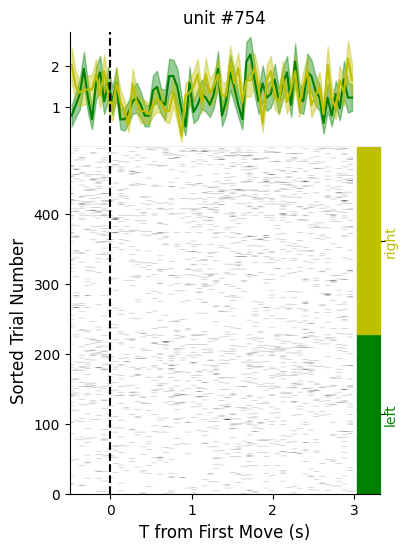

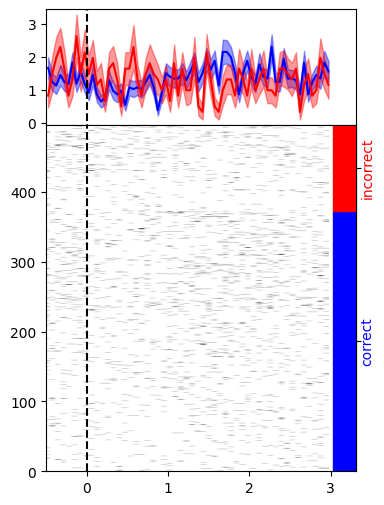

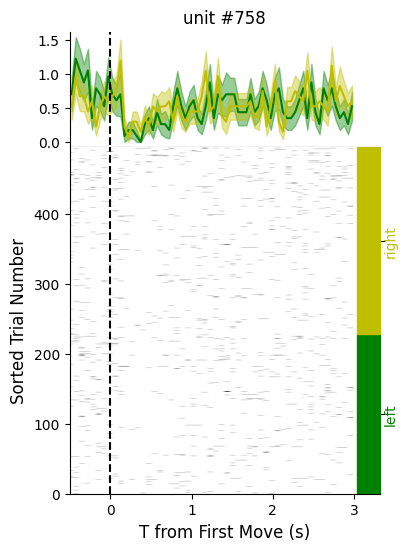

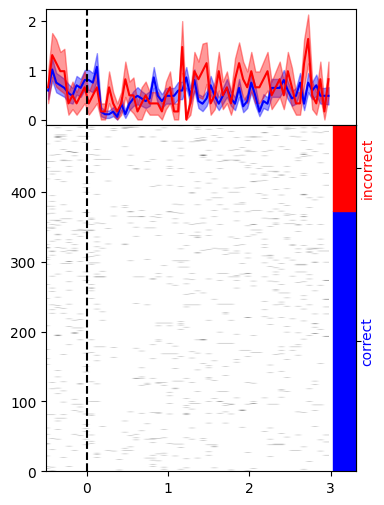

In [ ]:
# only for STR region, stimOn_times
from brainbox.task.trials import find_trial_ids
for ids in np.array(STR_df['cluster_id']):

  spikes_idx = spikes['clusters'] == ids
  order='trial num'

  xlabel='T from First Move (s)'
  label='T from First Move (s)'
  ylabel0='Firing Rate (Hz)'
  ylabel1='Sorted Trial Number'

  trial_idx, dividers = find_trial_ids(sl.trials, sort='side', order=order)
  trial_idx2, dividers2 = find_trial_ids(sl.trials, sort='choice', order=order)
  # single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True,
  #                               norm=False, axs=None):
  fig, axs = single_cluster_raster(
              spikes.times[spikes_idx], sl.trials['stimOn_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'])
  fig2, axs2 = single_cluster_raster(
              spikes.times[spikes_idx], sl.trials['stimOn_times'], trial_idx2, dividers2, ['b', 'r'], ['correct', 'incorrect'])
  set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
  set_axis_style(axs[0], ylabel=ylabel0)
  set_axis_style(axs[0], title="unit #"+str(ids))

<ipython-input-110-af5ef7cf3e7f>:29: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(2)


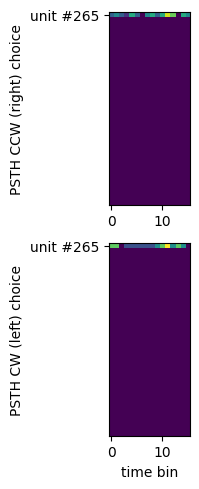

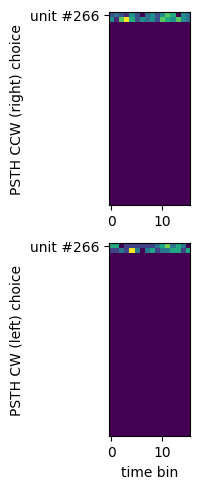

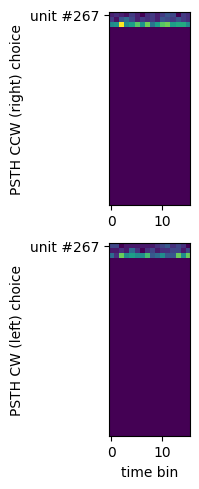

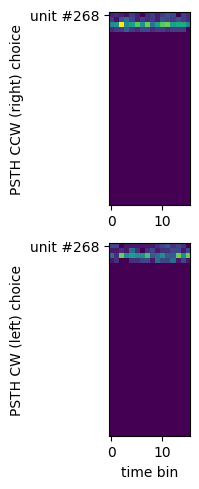

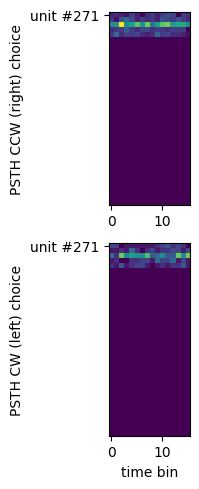

...

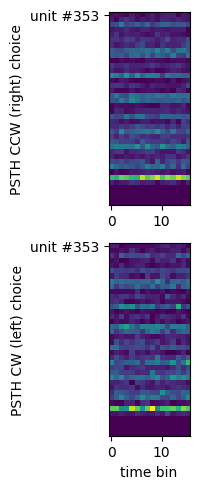

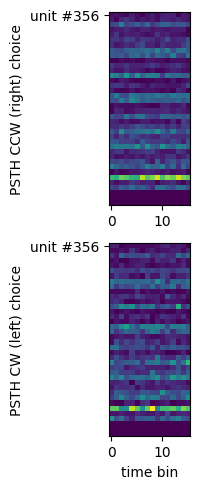

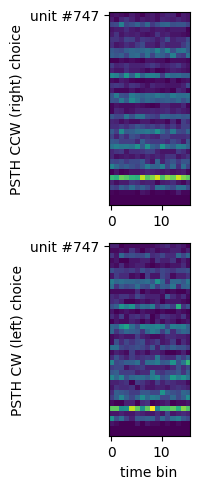

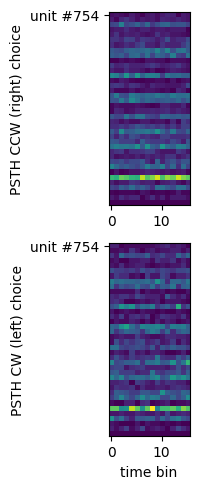

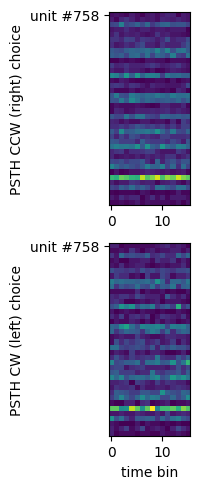

In [ ]:
binsize = 0.01  # bin size [sec] for neural binning
time_window = [-0.150, 0]
cluster_STR_IDs = np.array(STR_df['cluster_id'])

for count, clu_id in enumerate(cluster_STR_IDs):

    # Find spikes for this cluster
    spk_indx = np.where(np.isin(spikes_g['clusters'], clu_id))
    spikes_unit = {key: val[spk_indx] for key, val in spikes_g.items()}

    # Compute raster\
    raster, timestamps = get_event_aligned_raster(spikes_unit['times'], events, tbin=binsize, values=None, epoch=time_window, bin=True)

    # Compute PSTH (return only the mean)
    psth_a, _ = get_psth(raster, trial_ids=indx_choice_a)
    psth_b, _ = get_psth(raster, trial_ids=indx_choice_b)

    # ------- Stack PSTHs -------
    # Init ; Here we create a M = n condition x n unit x n time bin and will concatenate it later
    if count == 0:
      nbin = len(timestamps)
      nunit = len(cluster_STR_IDs)
      stack_psth = np.empty((2, nunit, nbin))

    stack_psth[0, count, :] = psth_a
    stack_psth[1, count, :] = psth_b

    # Plot stacked PSTHs
    fig, ax = plt.subplots(2)
    fig.set_size_inches(6.5, 5.5)
    ax[0].imshow(stack_psth[0, :, :], vmax=stack_psth.max(), vmin=stack_psth.min())
    ax[1].imshow(stack_psth[1, :, :], vmax=stack_psth.max(), vmin=stack_psth.min())
    ax[0].set_xlabel('')
    ax[1].set_xlabel('time bin')
    ax[0].set_ylabel('PSTH CCW (right) choice')
    ax[1].set_ylabel('PSTH CW (left) choice')

    ytick_loc = [0]
    ax[0].set_yticks(ytick_loc)
    ax[1].set_yticks(ytick_loc)
    ax[0].set_yticklabels(['unit #'+str(clu_id)])
    ax[1].set_yticklabels(['unit #'+str(clu_id)])


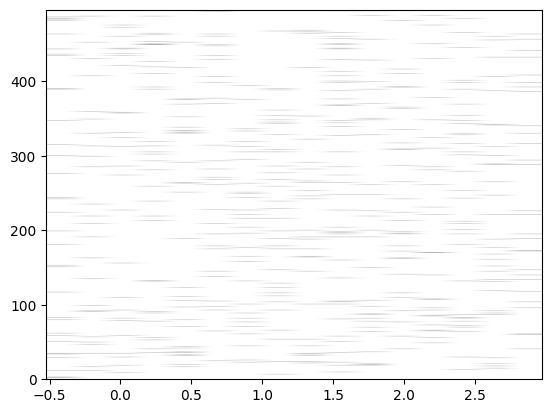

In [ ]:
binsize = 0.01  # bin size [sec] for neural binning
time_window = [-0.150, 0]
spk_indx = np.where(np.isin(spikes_g['clusters'], 281))
spikes_unit = {key: val[spk_indx] for key, val in spikes_g.items()}

# Compute raster\
raster, timestamps = get_event_aligned_raster(spikes_unit['times'], events, tbin=binsize, values=None, epoch=time_window, bin=True)
fig, ax = plt.subplots()
ax.imshow(raster, extent=[times[0], times[-1], 0, events.size], origin='lower', cmap='binary', aspect='auto', vmax=5, vmin=0)


##Raster Plot function

In [ ]:
def draw_raster_plot(cluster_id, bin_size, pre_time, post_time, vmax_):
  spikes_idx = spikes['clusters'] == cluster_id
  events = sl.trials['stimOn_times']
  #feedback = sl.trials['feedback_times']

  gap1 = sl.trials['firstMovement_times'] - sl.trials['stimOn_times']

  gap2 = sl.trials['feedback_times'] - sl.trials['stimOn_times']

  spike_raster, times = bin_spikes(spikes.times[spikes_idx], events, pre_time=pre_time, post_time=post_time, bin_size=bin_size)
  spikes_raster = spike_raster / bin_size
  fig, ax = plt.subplots()
  ax.imshow(spike_raster, extent=[times[0], times[-1], 0, events.size], origin='lower', cmap='binary', aspect='auto', vmax=vmax_, vmin=0)
  ax.axvline(0, c='k', linestyle='--')

  ax.axvline(gap1[0], c='r', linestyle='--')
  ax.axvline(gap2[0], c='g', linestyle='--')

  ax.set_xlabel('Time from stimulus (s)')
  ax.set_ylabel('Trial number')
  return spike_raster, times

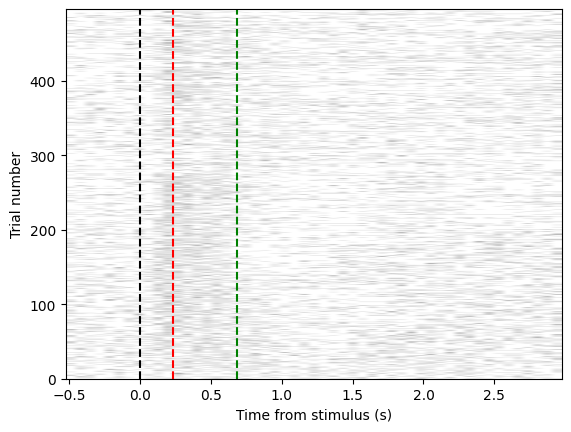

In [ ]:
spike_raster, times = draw_raster_plot(281, 0.07, 0.5, 3, 10)

##PSTH function

In [ ]:
def PSHT(spike_raster, times):
  left_idx = ~np.isnan(sl.trials['contrastLeft'])
  right_idx = ~np.isnan(sl.trials['contrastRight'])
  psth_left = np.nanmean(spike_raster[left_idx], axis=0)
  psth_right = np.nanmean(spike_raster[right_idx], axis=0)

  gap1 = sl.trials['firstMovement_times'] - sl.trials['stimOn_times']

  gap2 = sl.trials['feedback_times'] - sl.trials['stimOn_times']

  # Compute psth for correct vs incorrect trials
  #Whether the feedback was positive (+1) or negative (-1).
  #Positive feedback indicates a correct response rewarded with sugar water.
  #Negative feedback indicates a trial timeout or incorrect response followed by a white noise burst.
  correct_idx = sl.trials['feedbackType'] == 1
  incorrect_idx = sl.trials['feedbackType'] == -1
  psth_correct = np.nanmean(spike_raster[correct_idx], axis=0)
  psth_incorrect = np.nanmean(spike_raster[incorrect_idx], axis=0)

  # Plot the psths
  fig, axs = plt.subplots(1, 2)
  axs[0].plot(times, psth_left, c='green')
  axs[0].plot(times, psth_right, c='yellow')
  axs[0].legend(['left', 'right'])
  axs[0].axvline(0, c='k', linestyle='--')

  axs[0].axvline(gap1[0], c='r', linestyle='--')
  axs[0].axvline(gap2[0], c='g', linestyle='--')

  axs[0].set_xlabel('Time from stimulus (s)')
  axs[0].set_ylabel('Firing rate (Hz)')

  axs[1].plot(times, psth_correct, c='blue')
  axs[1].plot(times, psth_incorrect, c='red')
  axs[1].legend(['correct', 'incorrect'])
  axs[1].axvline(0, c='k', linestyle='--')

  axs[1].axvline(gap1[0], c='r', linestyle='--')
  axs[1].axvline(gap2[0], c='g', linestyle='--')

  axs[1].set_xlabel('Time from stimulus (s)')

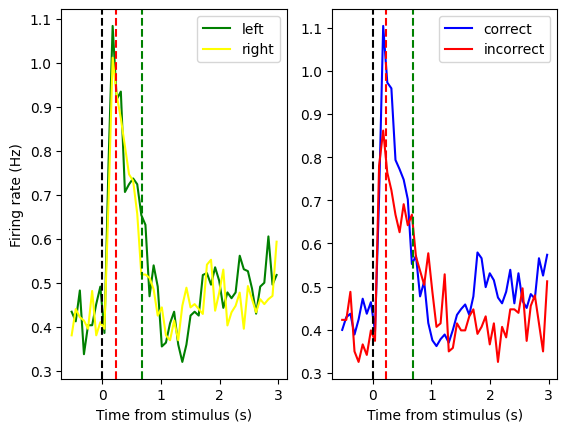

In [ ]:
PSHT(spike_raster, times)

In [ ]:
spikes_df = pd.DataFrame(spikes)
spikes_str_df = spikes_df[spikes_df['clusters'].isin(STR_df['cluster_id'])]
spikes_str_df.to_dict().keys()

dict_keys(['depths', 'times', 'clusters', 'amps'])

In [ ]:
#spikes

In [ ]:
a = spikes_str_df.to_dict(orient='list')

In [ ]:
spikes_array = {key: np.array(value) for key, value in a.items()}
spikes_array

{'depths': array([1482.97521973, 1370.19775391, 1205.39770508, ..., 1476.60534668,
        1176.87573242, 1279.20727539]),
 'times': array([3.25251586e-02, 4.00585070e-02, 5.16918634e-02, ...,
        5.81657941e+03, 5.81658468e+03, 5.81659448e+03]),
 'clusters': array([352, 326, 272, ..., 352, 268, 299]),
 'amps': array([2.60372844e-04, 2.21171694e-04, 9.03343744e-05, ...,
        2.35952899e-04, 2.75512290e-04, 1.30192145e-04])}

In [ ]:
channels_df = STR_df[['x', 'y', 'z', 'acronym', 'atlas_id', 'axial_um','lateral_um']]
channels_df.to_dict().keys()

dict_keys(['x', 'y', 'z', 'acronym', 'atlas_id', 'axial_um', 'lateral_um'])

In [ ]:
b = channels_df.to_dict(orient='list')

In [ ]:
channels_array = {key: np.array(value) for key, value in b.items()}

(<Figure size 1600x900 with 4 Axes>,
 array([[<Axes: title={'center': '2022-01-26_1_UCLA034_probe00, 6358854e-51d2-47de-a278-5cbfd155feb6 \n750_450 spikes, 38 clusters'}>,
         <Axes: >],
        [<Axes: xlabel='time (secs)', ylabel='depth (um)'>,
         <Axes: title={'center': 'alf'}>]], dtype=object))

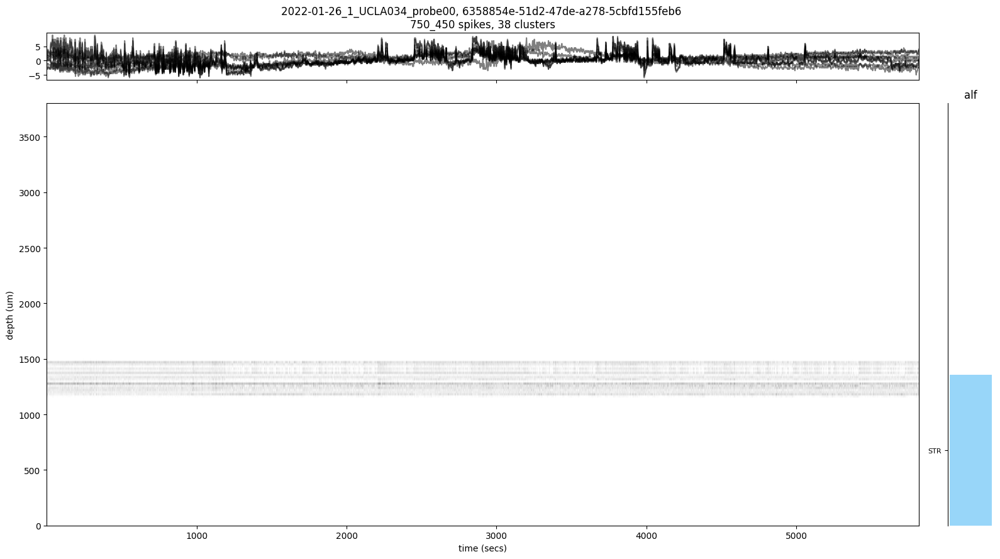

In [ ]:
ssl.raster(spikes_array, channels_array)

PSTH

In [ ]:
def single_cluster_raster(spike_times, events, trial_idx, dividers, colors, labels, weights=None, fr=True, norm=False,
                              axs=None):

  pre_time = 0.4
  post_time = 1
  raster_bin = 0.01
  psth_bin = 0.05
  raster, t_raster = bin_spikes(
      spike_times, events, pre_time=pre_time, post_time=post_time, bin_size=raster_bin, weights=weights)
  psth, t_psth = bin_spikes(
      spike_times, events, pre_time=pre_time, post_time=post_time, bin_size=psth_bin, weights=weights)

  if fr:
      psth = psth / psth_bin

  if norm:
      psth = psth - np.repeat(psth[:, 0][:, np.newaxis], psth.shape[1], axis=1)
      raster = raster - np.repeat(raster[:, 0][:, np.newaxis], raster.shape[1], axis=1)

  dividers = [0] + dividers + [len(trial_idx)]
  if axs is None:
      fig, axs = plt.subplots(2, 1, figsize=(4, 6), gridspec_kw={'height_ratios': [1, 3], 'hspace': 0}, sharex=True)
  else:
      fig = axs[0].get_figure()

  label, lidx = np.unique(labels, return_index=True)
  label_pos = []
  for lab, lid in zip(label, lidx):
      idx = np.where(np.array(labels) == lab)[0]
      for iD in range(len(idx)):
          if iD == 0:
              t_ids = trial_idx[dividers[idx[iD]] + 1:dividers[idx[iD] + 1] + 1]
              t_ints = dividers[idx[iD] + 1] - dividers[idx[iD]]
          else:
              t_ids = np.r_[t_ids, trial_idx[dividers[idx[iD]] + 1:dividers[idx[iD] + 1] + 1]]
              t_ints = np.r_[t_ints, dividers[idx[iD] + 1] - dividers[idx[iD]]]

      psth_div = np.nanmean(psth[t_ids], axis=0)
      std_div = np.nanstd(psth[t_ids], axis=0) / np.sqrt(len(t_ids))

      axs[0].fill_between(t_psth, psth_div - std_div,
                          psth_div + std_div, alpha=0.4, color=colors[lid])
      axs[0].plot(t_psth, psth_div, alpha=1, color=colors[lid])

      lab_max = idx[np.argmax(t_ints)]
      label_pos.append((dividers[lab_max + 1] - dividers[lab_max]) / 2 + dividers[lab_max])

  axs[1].imshow(raster[trial_idx], cmap='binary', origin='lower',
                extent=[np.min(t_raster), np.max(t_raster), 0, len(trial_idx)], aspect='auto')

  width = raster_bin * 4
  for iD in range(len(dividers) - 1):
      axs[1].fill_between([post_time + raster_bin / 2, post_time + raster_bin / 2 + width],
                          [dividers[iD + 1], dividers[iD + 1]], [dividers[iD], dividers[iD]], color=colors[iD])

  axs[1].set_xlim([-1 * pre_time, post_time + raster_bin / 2 + width])
  secax = axs[1].secondary_yaxis('right')

  secax.set_yticks(label_pos)
  secax.set_yticklabels(label, rotation=90,
                        rotation_mode='anchor', ha='center')
  for ic, c in enumerate(np.array(colors)[lidx]):
      secax.get_yticklabels()[ic].set_color(c)

  remove_spines(axs[1], spines=['right', 'top'])
  remove_spines(axs[0], spines=['right', 'top'])

  axs[0].axvline(0, *axs[0].get_ylim(), c='k', ls='--', zorder=10)  # TODO this doesn't always work
  axs[1].axvline(0, *axs[1].get_ylim(), c='k', ls='--', zorder=10)

  return fig, axs

In [ ]:
def plot_wheel_raster(self, axs=None, xlabel='T from First Move (s)', ylabel0='Wheel velocity (rad/s)',
                          ylabel1='Sorted Trial Number', title=None):
  wheel = load_wheel(self.eid)
  speed = velocity(wheel.timestamps, wheel.position)

  trial_idx, dividers = find_trial_ids(self.trials, sort='side')
  fig, axs = self.single_cluster_raster(
      wheel.timestamps, self.trials['firstMovement_times'], trial_idx, dividers, ['g', 'y'], ['left', 'right'],
      weights=speed, fr=False, axs=axs)

  set_axis_style(axs[1], xlabel=xlabel, ylabel=ylabel1)
  set_axis_style(axs[0], ylabel=ylabel0, title=title)

  return fig


Text(0.5, 0, 'Time from stimulus (s)')

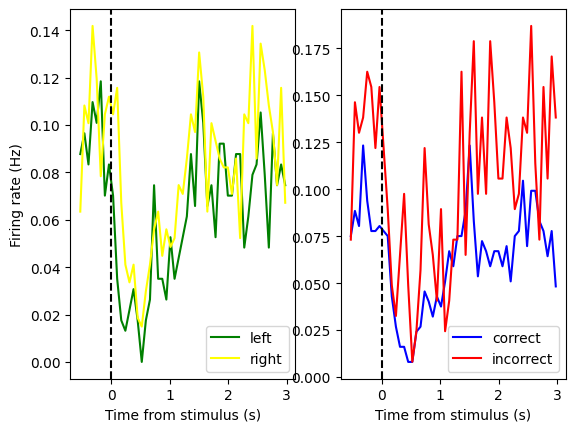

In [ ]:
# 4. Compute peri stimulus time histogram for different trial events
# Compute psth for left vs right stimulus trials
left_idx = ~np.isnan(sl.trials['contrastLeft'])
right_idx = ~np.isnan(sl.trials['contrastRight'])
psth_left = np.nanmean(spike_raster[left_idx], axis=0)
psth_right = np.nanmean(spike_raster[right_idx], axis=0)

# Compute psth for correct vs incorrect trials
#Whether the feedback was positive (+1) or negative (-1).
#Positive feedback indicates a correct response rewarded with sugar water.
#Negative feedback indicates a trial timeout or incorrect response followed by a white noise burst.
correct_idx = sl.trials['feedbackType'] == 1
incorrect_idx = sl.trials['feedbackType'] == -1
psth_correct = np.nanmean(spike_raster[correct_idx], axis=0)
psth_incorrect = np.nanmean(spike_raster[incorrect_idx], axis=0)

# Plot the psths
fig, axs = plt.subplots(1, 2)
axs[0].plot(times, psth_left, c='green')
axs[0].plot(times, psth_right, c='yellow')
axs[0].legend(['left', 'right'])
axs[0].axvline(0, c='k', linestyle='--')
axs[0].set_xlabel('Time from stimulus (s)')
axs[0].set_ylabel('Firing rate (Hz)')

axs[1].plot(times, psth_correct, c='blue')
axs[1].plot(times, psth_incorrect, c='red')
axs[1].legend(['correct', 'incorrect'])
axs[1].axvline(0, c='k', linestyle='--')
axs[1].set_xlabel('Time from stimulus (s)')

(552, 6)

array([0.39855072, 0.45652174, 0.55072464, 0.51086957, 0.35869565,
       0.34782609])

In [ ]:
# ---------------------------------------------------
# Select a time window of interest
time_window = np.array([-0.1, 0.0])  # 100 ms before the event

In [ ]:
#to do: do we need wheel data?

In [ ]:
# ---------------------------------------------------
# Compute spike rate around event
events_tw = np.array([events+time_window[0], events+time_window[1]]).T #the event is a time point
#our window start 100ms before each event (that is: before the mouse moves the wheel), the time window before the action may be where decision happened

# Compute count (for all clusters of interest) (THIS CAN TAKE A WHILE)
spike_count, cluster_id = get_spike_counts_in_bins(spikes_g['times'], spikes_g['clusters'], events_tw) #agg count

# Compute rate (for all clusters of interest)
spike_rate = np.zeros((num_neuron, num_trial))
spike_rate = spike_count / (time_window[1] - time_window[0]) #spike count / time window length

# ---------------------------------------------------
# Compute the modulation index
modulation_index = np.divide((np.mean(spike_rate[:, indx_choice_a], 1) - np.mean(spike_rate[:, indx_choice_b], 1)),
                             (np.mean(spike_rate[:, indx_choice_a], 1) + np.mean(spike_rate[:, indx_choice_b], 1)))
#To do: what is this? The modulation index (or modulation depth) of a modulation scheme describes by how much the modulated variable of the carrier signal varies around its unmodulated level. It is defined differently in each modulation scheme.

<ipython-input-24-718e6633ba8d>:15: RuntimeWarning: invalid value encountered in divide
  modulation_index = np.divide((np.mean(spike_rate[:, indx_choice_a], 1) - np.mean(spike_rate[:, indx_choice_b], 1)),


In [ ]:
modulation_index

array([ 0.52459016,  0.07121787,  0.34782609,  0.38791174,  0.1871588 ,
        0.32755379, -0.37650845,  0.45539906,  0.15022358, -0.44741533,
       -1.        , -0.08136807,  0.25788585, -0.11004785,  0.00486224,
        0.13654038, -0.01430843, -0.02554028,  0.15660576,  0.23125669,
        0.14963346,  0.04750963, -0.33237617, -0.12700648, -0.3777183 ,
       -0.3654043 , -0.40430438, -0.4217959 ,  0.37515843, -0.17580592,
       -0.07330961,  0.21238457,         nan, -0.23628963, -0.28472543,
        0.39097049, -0.23343225,  0.27257159, -0.17374136,  0.14391144,
        0.2631338 , -0.57823129, -0.14040837,  0.07616908, -0.21848739,
        0.23010062,  0.20546663, -1.        , -0.45306987,  0.45539906,
        0.14009884, -0.20228735, -0.45882159,  0.23067582,  0.36991346,
        0.31244708,  0.25837223,  0.25100888,  0.14950278, -0.3616145 ,
       -0.17136917,  0.208577  , -0.03454134, -0.37789901,  0.13736466,
        0.09634869, -0.25480769,  0.15694363,  0.42763158,  0.50

In [ ]:
print('# of time bins --> trials (in each cluster): '+str(len(spike_count[0])))
print('# of cluster (in each row): ' +str(len(spike_count)))

# of time bins --> trials (in each cluster): 552
# of cluster (in each row): 248


In [ ]:
# ---------------------------------------------------
# Compute p-value to assess significance of encoding (THIS CAN TAKE A WHILE)
p_1 = get_choice_time_shuffle(spike_rate, contrast_L, contrast_R, block, choice, 1000)
#does the behavior of mice appear stastically significant
# Find those that are significant to 0.01
p_sig = np.zeros(p_1.shape)
p_sig[np.where(p_1 < 0.01)] = 1

Now we plot the modulation index value for each neuron along the probe depth, colored according to the level of significance. We can see that only one unit is significantly modulated (the one colored in yellow).

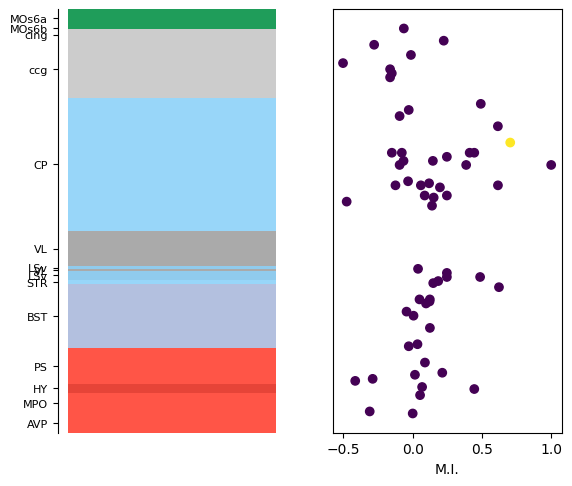

In [ ]:
#encodig of decision, cues, stimulus appear
#significant of respond to what
#stimulus cells, decision cells, reward cells. cues
#mix selectivity
#each cell have a propotion to different
#signal of noise ratio
#plot when insertion = 10
# ---------------------------------------------------
# Plot the modulation index for each unit across brain regions
fig, axs = plt.subplots(1, 2)
fig.set_size_inches(6.5, 5.5)
# Plot the brain regions through which the channels on the insertion pass
plot_brain_regions(channels['atlas_id'], channel_depths=channels['axial_um'], ax=axs[0])
# Plot scatter plot of cluster depths vs cluster modulation index
axs[1].scatter(modulation_index, clusters_g['depths'], c=p_sig)  # color by significance
axs[1].set_xlabel('M.I.')
axs[1].get_yaxis().set_visible(False)
#to do: are we finding cluster with high level of significance?

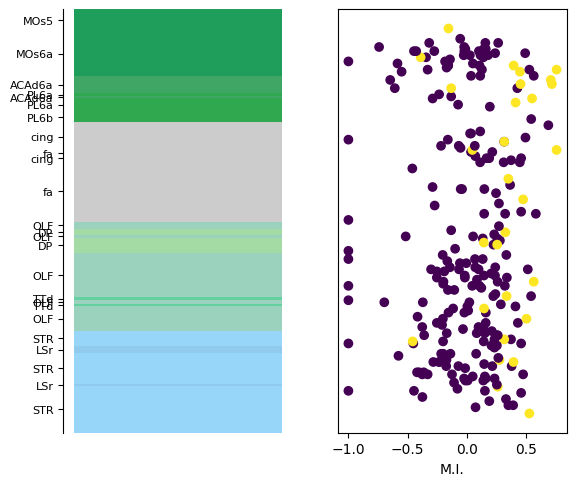

In [ ]:
#plot when insertion = 43
# ---------------------------------------------------
# Plot the modulation index for each unit across brain regions
fig, axs = plt.subplots(1, 2)
fig.set_size_inches(6.5, 5.5)
# Plot the brain regions through which the channels on the insertion pass
plot_brain_regions(channels['atlas_id'], channel_depths=channels['axial_um'], ax=axs[0])
# Plot scatter plot of cluster depths vs cluster modulation index
axs[1].scatter(modulation_index, clusters_g['depths'], c=p_sig)  # color by significance
axs[1].set_xlabel('M.I.')
axs[1].get_yaxis().set_visible(False)
#to do: are we finding cluster with high level of significance?

In [ ]:
#can try to see if units are also selective to left / right conditions _after_ the first move, or _after_ the stimulus onset for example.

In [ ]:
cluster_STR_IDs = np.array(STR_df['cluster_id'])#np.array([161, 386])

In [ ]:
# ---------------------------------------------------
# Create PSTHs
binsize = 0.01  # bin size [sec] for neural binning
time_window = [-0.150, 0]

for count, clu_id in enumerate(cluster_STR_IDs):

    # Find spikes for this cluster
    spk_indx = np.where(np.isin(spikes_g['clusters'], clu_id))
    spikes_unit = {key: val[spk_indx] for key, val in spikes_g.items()}

    # Compute raster
    raster, timestamps = get_event_aligned_raster(spikes_unit['times'], events, tbin=binsize, values=None,
                                                  epoch=time_window, bin=True)
    # Compute PSTH (return only the mean)
    psth_a, _ = get_psth(raster, trial_ids=indx_choice_a)
    psth_b, _ = get_psth(raster, trial_ids=indx_choice_b)

    # ------- Stack PSTHs -------
    # Init ; Here we create a M = n condition x n unit x n time bin and will concatenate it later
    if count == 0:
        nbin = len(timestamps)
        nunit = len(cluster_STR_IDs)
        stack_psth = np.empty((2, nunit, nbin))

    stack_psth[0, count, :] = psth_a
    stack_psth[1, count, :] = psth_b

/usr/local/lib/python3.10/dist-packages/brainbox/task/trials.py:196: RuntimeWarning: Mean of empty slice
  mean = np.nanmean(raster, axis=0)
/usr/local/lib/python3.10/dist-packages/numpy/lib/nanfunctions.py:1878: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


[Text(0, 0, 'unit #1')]

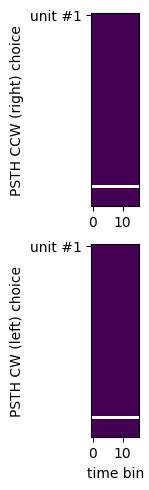

In [ ]:
# ---------------------------------------------------
# Plot stacked PSTHs
fig, ax = plt.subplots(2)
fig.set_size_inches(6.5, 5.5)
ax[0].imshow(stack_psth[0, :, :], vmax=stack_psth.max(), vmin=stack_psth.min())
ax[1].imshow(stack_psth[1, :, :], vmax=stack_psth.max(), vmin=stack_psth.min())
ax[0].set_xlabel('')
ax[1].set_xlabel('time bin')
ax[0].set_ylabel('PSTH CCW (right) choice')
ax[1].set_ylabel('PSTH CW (left) choice')

ytick_loc = [0]
ax[0].set_yticks(ytick_loc)
ax[1].set_yticks(ytick_loc)
ax[0].set_yticklabels(['unit #1'])
ax[1].set_yticklabels(['unit #1'])

In [ ]:
# ---------------------------------------------------
# Check that there are indeed only 2 values in choice
assert len(np.unique(choice)) == 2

# ---------------------------------------------------
# Use the spike count in the time window prior to the movement onset as predictors.
# We use the same time window as defined earlier (Encoding)
X = spike_count.T  # shape of spike_count : n units x n trials in set -> transpose to fit model
y = choice

# ---------------------------------------------------
# Split trials into test and training sets for the logistic regression.
# Take first half of trials for training, second half for testing (test_size = 0.5)
# Fix random seed to repeat results across runs
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.5, random_state=0)

# ---------------------------------------------------
# See how many trials there is for choice +1 ; -1
print(f'Training set : {len(np.where(y_train == 1)[0])} choice +1 / {len(y_train)} trials')
print(f'Testing set : {len(np.where(y_test == 1)[0])} choice +1 / {len(y_test)} trials')

Training set : 270 choice +1 / 441 trials
Testing set : 280 choice +1 / 441 trials


In [ ]:
# ---------------------------------------------------
# Fit the logistic regression model
clf = LogisticRegression(random_state=0).fit(X_train, y_train)

# Use the test set to assess the model accuracy
choice_predicted = clf.predict(X_test)
n_trial_correct = len(np.where(y_test == choice_predicted)[0])
print(f'Accuracy : {n_trial_correct} trials correctly predicted / {len(y_test)} trials')
acc = n_trial_correct/len(y_test)
print(f'Accracy score : {acc}')

Accuracy : 287 trials correctly predicted / 441 trials
Accracy score : 0.6507936507936508


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
